In [1]:
# Initial imports
import os
import numpy as np
import pandas as pd
import hvplot.pandas
from path import Path
import plotly.express as px
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
from scipy import stats
from itertools import combinations


In [2]:
#read in the CSV as a dataframe 
df = pd.read_csv('fifa_cleaned.csv', index_col = 0)
df

,name,full_name,birth_date,age,height_cm,weight_kgs,positions,nationality,overall_rating,potential,...,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB
id,,,,,,,,,,,,,,,,,,,,,
158023,L. Messi,Lionel Andrés Messi Cuccittini,24/06/87,31,170.18,72.1,"CF,RW,ST",Argentina,94,94,...,64+2,61+2,61+2,61+2,64+2,59+2,48+2,48+2,48+2,59+2
190460,C. Eriksen,Christian Dannemann Eriksen,14/02/92,27,154.94,76.2,"CAM,RM,CM",Denmark,88,89,...,71+3,71+3,71+3,71+3,71+3,66+3,57+3,57+3,57+3,66+3
195864,P. Pogba,Paul Pogba,15/03/93,25,190.50,83.9,"CM,CAM",France,88,91,...,76+3,77+3,77+3,77+3,76+3,74+3,72+3,72+3,72+3,74+3
198219,L. Insigne,Lorenzo Insigne,04/06/91,27,162.56,59.0,"LW,ST",Italy,88,88,...,63+3,58+3,58+3,58+3,63+3,58+3,44+3,44+3,44+3,58+3
201024,K. Koulibaly,Kalidou Koulibaly,20/06/91,27,187.96,88.9,CB,Senegal,88,91,...,73+3,77+3,77+3,77+3,73+3,76+3,85+3,85+3,85+3,76+3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204322,R. McKenzie,Rory McKenzie,07/10/93,25,175.26,74.8,"RM,CAM,CM",Scotland,67,70,...,53+2,52+2,52+2,52+2,53+2,50+2,46+2,46+2,46+2,50+2
239762,M. Sipľak,Michal Sipľak,02/02/96,23,182.88,79.8,LB,Slovakia,59,67,...,57+2,55+2,55+2,55+2,57+2,57+2,58+2,58+2,58+2,57+2
235155,J. Bekkema,Jan Bekkema,09/04/96,22,185.42,89.8,GK,Netherlands,59,67,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
df.columns

Index(['name', 'full_name', 'birth_date', 'age', 'height_cm', 'weight_kgs',
       'positions', 'nationality', 'overall_rating', 'potential', 'value_euro',
       'wage_euro', 'preferred_foot', 'international_reputation(1-5)',
       'weak_foot(1-5)', 'skill_moves(1-5)', 'work_rate', 'body_type',
       'release_clause_euro', 'club_team', 'club_rating', 'club_position',
       'club_jersey_number', 'club_join_date', 'contract_end_year',
       'national_team', 'national_rating', 'national_team_position',
       'national_jersey_number', 'crossing', 'finishing', 'heading_accuracy',
       'short_passing', 'volleys', 'dribbling', 'curve', 'freekick_accuracy',
       'long_passing', 'ball_control', 'acceleration', 'sprint_speed',
       'agility', 'reactions', 'balance', 'shot_power', 'jumping', 'stamina',
       'strength', 'long_shots', 'aggression', 'interceptions', 'positioning',
       'vision', 'penalties', 'composure', 'marking', 'standing_tackle',
       'sliding_tackle', 'GK_divi

In [4]:
df.describe()

,age,height_cm,weight_kgs,overall_rating,potential,value_euro,wage_euro,international_reputation(1-5),weak_foot(1-5),skill_moves(1-5),...,penalties,composure,marking,standing_tackle,sliding_tackle,GK_diving,GK_handling,GK_kicking,GK_positioning,GK_reflexes
count,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000,1.769900e+04,17708.000000,17954.000000,17954.000000,17954.000000,...,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000,17954.000000
mean,25.565445,174.946921,75.301047,66.240169,71.430935,2.479280e+06,9902.134628,1.111674,2.945695,2.361034,...,48.357302,58.680183,47.162861,47.733040,45.705915,16.784449,16.556199,16.388660,16.541049,16.874067
std,4.705708,14.029449,7.083684,6.963730,6.131339,5.687014e+06,21995.593750,0.392168,0.663691,0.763223,...,15.810844,11.625541,20.037346,21.674973,21.285812,17.893895,17.108234,16.701447,17.231495,18.182943
min,17.000000,152.400000,49.900000,47.000000,48.000000,1.000000e+04,1000.000000,1.000000,1.000000,1.000000,...,5.000000,12.000000,3.000000,2.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,22.000000,154.940000,69.900000,62.000000,67.000000,3.250000e+05,1000.000000,1.000000,3.000000,2.000000,...,38.000000,51.000000,30.000000,27.000000,24.000000,8.000000,8.000000,8.000000,8.000000,8.000000
50%,25.000000,175.260000,74.800000,66.000000,71.000000,7.000000e+05,3000.000000,1.000000,3.000000,2.000000,...,49.000000,60.000000,52.500000,55.000000,52.000000,11.000000,11.000000,11.000000,11.000000,11.000000
75%,29.000000,185.420000,79.800000,71.000000,75.000000,2.100000e+06,9000.000000,1.000000,3.000000,3.000000,...,60.000000,67.000000,64.000000,66.000000,64.000000,14.000000,14.000000,14.000000,14.000000,14.000000
max,46.000000,205.740000,110.200000,94.000000,95.000000,1.105000e+08,565000.000000,5.000000,5.000000,5.000000,...,92.000000,96.000000,94.000000,93.000000,90.000000,90.000000,92.000000,92.000000,90.000000,94.000000


In [5]:
from itertools import combinations

FW_LIST = ['CF','RF','LF','ST']
FW_COMB = list()

for n in range(len(FW_LIST) + 1):
    FW_COMB += list(combinations(FW_LIST, n))
    
FW_COMB


[(),
 ('CF',),
 ('RF',),
 ('LF',),
 ('ST',),
 ('CF', 'RF'),
 ('CF', 'LF'),
 ('CF', 'ST'),
 ('RF', 'LF'),
 ('RF', 'ST'),
 ('LF', 'ST'),
 ('CF', 'RF', 'LF'),
 ('CF', 'RF', 'ST'),
 ('CF', 'LF', 'ST'),
 ('RF', 'LF', 'ST'),
 ('CF', 'RF', 'LF', 'ST')]

In [6]:
MF_LIST = ['AM','CAM','CDM','LM','RM','RW','LW','DM','CM']
MF_COMB = list()

for n in range(len(MF_LIST) + 1):
    MF_COMB += list(combinations(MF_LIST, n))
MF_COMB

[(),
 ('AM',),
 ('CAM',),
 ('CDM',),
 ('LM',),
 ('RM',),
 ('RW',),
 ('LW',),
 ('DM',),
 ('CM',),
 ('AM', 'CAM'),
 ('AM', 'CDM'),
 ('AM', 'LM'),
 ('AM', 'RM'),
 ('AM', 'RW'),
 ('AM', 'LW'),
 ('AM', 'DM'),
 ('AM', 'CM'),
 ('CAM', 'CDM'),
 ('CAM', 'LM'),
 ('CAM', 'RM'),
 ('CAM', 'RW'),
 ('CAM', 'LW'),
 ('CAM', 'DM'),
 ('CAM', 'CM'),
 ('CDM', 'LM'),
 ('CDM', 'RM'),
 ('CDM', 'RW'),
 ('CDM', 'LW'),
 ('CDM', 'DM'),
 ('CDM', 'CM'),
 ('LM', 'RM'),
 ('LM', 'RW'),
 ('LM', 'LW'),
 ('LM', 'DM'),
 ('LM', 'CM'),
 ('RM', 'RW'),
 ('RM', 'LW'),
 ('RM', 'DM'),
 ('RM', 'CM'),
 ('RW', 'LW'),
 ('RW', 'DM'),
 ('RW', 'CM'),
 ('LW', 'DM'),
 ('LW', 'CM'),
 ('DM', 'CM'),
 ('AM', 'CAM', 'CDM'),
 ('AM', 'CAM', 'LM'),
 ('AM', 'CAM', 'RM'),
 ('AM', 'CAM', 'RW'),
 ('AM', 'CAM', 'LW'),
 ('AM', 'CAM', 'DM'),
 ('AM', 'CAM', 'CM'),
 ('AM', 'CDM', 'LM'),
 ('AM', 'CDM', 'RM'),
 ('AM', 'CDM', 'RW'),
 ('AM', 'CDM', 'LW'),
 ('AM', 'CDM', 'DM'),
 ('AM', 'CDM', 'CM'),
 ('AM', 'LM', 'RM'),
 ('AM', 'LM', 'RW'),
 ('AM', 'LM', 'LW'

In [7]:
DF_LIST = ['SW','RWB','LWB','RB','LB','CB']
DF_COMB = list()

for n in range(len(DF_LIST) + 1):
    DF_COMB += list(combinations(DF_LIST, n))
DF_COMB

[(),
 ('SW',),
 ('RWB',),
 ('LWB',),
 ('RB',),
 ('LB',),
 ('CB',),
 ('SW', 'RWB'),
 ('SW', 'LWB'),
 ('SW', 'RB'),
 ('SW', 'LB'),
 ('SW', 'CB'),
 ('RWB', 'LWB'),
 ('RWB', 'RB'),
 ('RWB', 'LB'),
 ('RWB', 'CB'),
 ('LWB', 'RB'),
 ('LWB', 'LB'),
 ('LWB', 'CB'),
 ('RB', 'LB'),
 ('RB', 'CB'),
 ('LB', 'CB'),
 ('SW', 'RWB', 'LWB'),
 ('SW', 'RWB', 'RB'),
 ('SW', 'RWB', 'LB'),
 ('SW', 'RWB', 'CB'),
 ('SW', 'LWB', 'RB'),
 ('SW', 'LWB', 'LB'),
 ('SW', 'LWB', 'CB'),
 ('SW', 'RB', 'LB'),
 ('SW', 'RB', 'CB'),
 ('SW', 'LB', 'CB'),
 ('RWB', 'LWB', 'RB'),
 ('RWB', 'LWB', 'LB'),
 ('RWB', 'LWB', 'CB'),
 ('RWB', 'RB', 'LB'),
 ('RWB', 'RB', 'CB'),
 ('RWB', 'LB', 'CB'),
 ('LWB', 'RB', 'LB'),
 ('LWB', 'RB', 'CB'),
 ('LWB', 'LB', 'CB'),
 ('RB', 'LB', 'CB'),
 ('SW', 'RWB', 'LWB', 'RB'),
 ('SW', 'RWB', 'LWB', 'LB'),
 ('SW', 'RWB', 'LWB', 'CB'),
 ('SW', 'RWB', 'RB', 'LB'),
 ('SW', 'RWB', 'RB', 'CB'),
 ('SW', 'RWB', 'LB', 'CB'),
 ('SW', 'LWB', 'RB', 'LB'),
 ('SW', 'LWB', 'RB', 'CB'),
 ('SW', 'LWB', 'LB', 'CB'),
 ('

In [8]:
positions_df=df
positions_df['positions'] = positions_df['positions'].replace(['FW_COMB'],'FW')
positions_df['positions'] = positions_df['positions'].replace(['MF_COMB'],'MF')
positions_df['positions'] = positions_df['positions'].replace(['DF_COMB'],'DF')
positions_df

,name,full_name,birth_date,age,height_cm,weight_kgs,positions,nationality,overall_rating,potential,...,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB
id,,,,,,,,,,,,,,,,,,,,,
158023,L. Messi,Lionel Andrés Messi Cuccittini,24/06/87,31,170.18,72.1,"CF,RW,ST",Argentina,94,94,...,64+2,61+2,61+2,61+2,64+2,59+2,48+2,48+2,48+2,59+2
190460,C. Eriksen,Christian Dannemann Eriksen,14/02/92,27,154.94,76.2,"CAM,RM,CM",Denmark,88,89,...,71+3,71+3,71+3,71+3,71+3,66+3,57+3,57+3,57+3,66+3
195864,P. Pogba,Paul Pogba,15/03/93,25,190.50,83.9,"CM,CAM",France,88,91,...,76+3,77+3,77+3,77+3,76+3,74+3,72+3,72+3,72+3,74+3
198219,L. Insigne,Lorenzo Insigne,04/06/91,27,162.56,59.0,"LW,ST",Italy,88,88,...,63+3,58+3,58+3,58+3,63+3,58+3,44+3,44+3,44+3,58+3
201024,K. Koulibaly,Kalidou Koulibaly,20/06/91,27,187.96,88.9,CB,Senegal,88,91,...,73+3,77+3,77+3,77+3,73+3,76+3,85+3,85+3,85+3,76+3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204322,R. McKenzie,Rory McKenzie,07/10/93,25,175.26,74.8,"RM,CAM,CM",Scotland,67,70,...,53+2,52+2,52+2,52+2,53+2,50+2,46+2,46+2,46+2,50+2
239762,M. Sipľak,Michal Sipľak,02/02/96,23,182.88,79.8,LB,Slovakia,59,67,...,57+2,55+2,55+2,55+2,57+2,57+2,58+2,58+2,58+2,57+2
235155,J. Bekkema,Jan Bekkema,09/04/96,22,185.42,89.8,GK,Netherlands,59,67,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
j = ['FW','MF','DW']
positions_df = positions_df[~positions_df['positions'].isin(j)]
positions_df

,name,full_name,birth_date,age,height_cm,weight_kgs,positions,nationality,overall_rating,potential,...,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB
id,,,,,,,,,,,,,,,,,,,,,
158023,L. Messi,Lionel Andrés Messi Cuccittini,24/06/87,31,170.18,72.1,"CF,RW,ST",Argentina,94,94,...,64+2,61+2,61+2,61+2,64+2,59+2,48+2,48+2,48+2,59+2
190460,C. Eriksen,Christian Dannemann Eriksen,14/02/92,27,154.94,76.2,"CAM,RM,CM",Denmark,88,89,...,71+3,71+3,71+3,71+3,71+3,66+3,57+3,57+3,57+3,66+3
195864,P. Pogba,Paul Pogba,15/03/93,25,190.50,83.9,"CM,CAM",France,88,91,...,76+3,77+3,77+3,77+3,76+3,74+3,72+3,72+3,72+3,74+3
198219,L. Insigne,Lorenzo Insigne,04/06/91,27,162.56,59.0,"LW,ST",Italy,88,88,...,63+3,58+3,58+3,58+3,63+3,58+3,44+3,44+3,44+3,58+3
201024,K. Koulibaly,Kalidou Koulibaly,20/06/91,27,187.96,88.9,CB,Senegal,88,91,...,73+3,77+3,77+3,77+3,73+3,76+3,85+3,85+3,85+3,76+3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204322,R. McKenzie,Rory McKenzie,07/10/93,25,175.26,74.8,"RM,CAM,CM",Scotland,67,70,...,53+2,52+2,52+2,52+2,53+2,50+2,46+2,46+2,46+2,50+2
239762,M. Sipľak,Michal Sipľak,02/02/96,23,182.88,79.8,LB,Slovakia,59,67,...,57+2,55+2,55+2,55+2,57+2,57+2,58+2,58+2,58+2,57+2
235155,J. Bekkema,Jan Bekkema,09/04/96,22,185.42,89.8,GK,Netherlands,59,67,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
pd.set_option('display.max_rows', None)


In [11]:
z=positions_df['positions'].value_counts()
z

CB               2243
GK               2065
ST               1747
CM                764
CDM,CM            709
LB                672
CM,CDM            632
RB                605
CDM               321
CB,RB             268
RM                261
CAM               250
LM                223
RM,LM             219
CB,LB             207
CB,CDM            205
CAM,CM            195
CM,CAM            194
LB,LM             193
LM,RM             188
RB,CB             135
RB,RM             121
RB,LB             121
LB,LWB            119
ST,RM             106
RB,RWB            104
CDM,CB            104
LB,CB             101
ST,RW              93
ST,CAM             92
ST,LM              90
LW                 84
ST,LW              77
RW                 73
CM,CDM,CAM         72
RM,ST              70
LM,CAM             69
LW,RW              68
CAM,LM             66
CM,CAM,CDM         66
LB,RB              65
CAM,RM             62
LM,ST              62
RW,LW              61
CM,RM              59
ST,CF     

In [12]:
positons_age_wage_df = positions_df.sample(150)
positons_age_wage_df

,name,full_name,birth_date,age,height_cm,weight_kgs,positions,nationality,overall_rating,potential,...,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB
id,,,,,,,,,,,,,,,,,,,,,
242935,A. Modiba,Maphosa Modiba,22/07/95,23,170.18,69.9,"LW,LB,RW,LM",South Africa,68,76,...,64+2,59+2,59+2,59+2,64+2,63+2,56+2,56+2,56+2,63+2
204963,Carvajal,Daniel Carvajal Ramos,11/01/92,27,172.72,73.0,RB,Spain,85,86,...,83+3,81+3,81+3,81+3,83+3,83+3,80+3,80+3,80+3,83+3
242114,I. Mahnashi,Ibrahim Mahnashi,18/11/99,19,170.18,69.9,"CDM,CM",Saudi Arabia,57,75,...,55+2,56+2,56+2,56+2,55+2,56+2,55+2,55+2,55+2,56+2
224980,M. Busch,Marnon Busch,08/12/94,24,182.88,79.8,"RB,RM",Germany,68,73,...,67+2,63+2,63+2,63+2,67+2,66+2,64+2,64+2,64+2,66+2
214392,J. Cuero,Jefferson Cuero Castro,15/05/88,30,175.26,69.9,"LM,RM",Colombia,71,71,...,60+2,54+2,54+2,54+2,60+2,58+2,49+2,49+2,49+2,58+2
246690,A. Bareiro,Adam Bareiro,26/07/96,22,182.88,83.9,ST,Paraguay,67,78,...,39+2,37+2,37+2,37+2,39+2,38+2,36+2,36+2,36+2,38+2
209997,K. Wimmer,Kevin Wimmer,15/11/92,26,187.96,84.8,CB,Austria,74,78,...,65+2,71+2,71+2,71+2,65+2,67+2,73+2,73+2,73+2,67+2
192695,N. Thompson,Nathan Thompson,09/11/90,28,172.72,71.2,"RB,CDM,CB",England,66,66,...,64+2,64+2,64+2,64+2,64+2,64+2,67+2,67+2,67+2,64+2
229880,A. Wan-Bissaka,Aaron Wan-Bissaka,26/11/97,21,182.88,72.1,RB,England,76,84,...,73+2,69+2,69+2,69+2,73+2,74+2,72+2,72+2,72+2,74+2


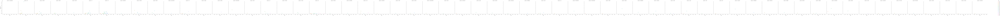

In [13]:

sns.lmplot(x="age", y="value_euro", hue="age",
           col="positions",  data=positons_age_wage_df);

In [14]:
val_df = df['value_euro'].div(1000000)
val_df.describe()

count    17699.000000
mean         2.479280
std          5.687014
min          0.010000
25%          0.325000
50%          0.700000
75%          2.100000
max        110.500000
Name: value_euro, dtype: float64

In [15]:
age_df = df['age']
age_df.describe()

count    17954.000000
mean        25.565445
std          4.705708
min         17.000000
25%         22.000000
50%         25.000000
75%         29.000000
max         46.000000
Name: age, dtype: float64

<function matplotlib.pyplot.show(close=None, block=None)>

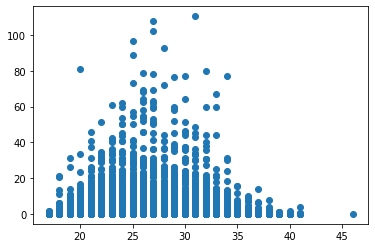

In [16]:
y = val_df
x = age_df
plt.plot(x,y,'o')
plt.show

<AxesSubplot:xlabel='age', ylabel='value_euro'>

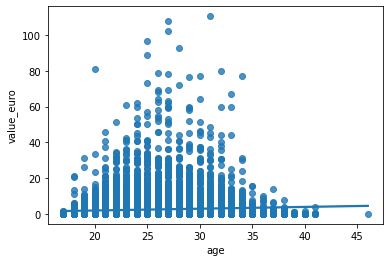

In [54]:

xdata =age_df
ydata = val_df
from scipy import stats
slope, intercept, r_value, p_value, std_err = stats.linregress(xdata, ydata)

import seaborn as sns
sns.regplot(x = xdata, y = ydata)


In [18]:
rep = df['international_reputation(1-5)']

<function matplotlib.pyplot.show(close=None, block=None)>

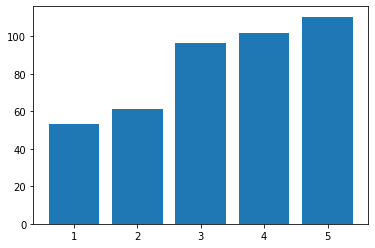

In [19]:
x = rep
y = val_df
plt.bar(x,y,)
plt.show

In [20]:
df.loc[df['international_reputation(1-5)'] == 1].count()


name                             16370
full_name                        16370
birth_date                       16370
age                              16370
height_cm                        16370
weight_kgs                       16370
positions                        16370
nationality                      16370
overall_rating                   16370
potential                        16370
value_euro                       16135
wage_euro                        16141
preferred_foot                   16370
international_reputation(1-5)    16370
weak_foot(1-5)                   16370
skill_moves(1-5)                 16370
work_rate                        16370
body_type                        16370
release_clause_euro              14701
club_team                        16356
club_rating                      16356
club_position                    16356
club_jersey_number               16356
club_join_date                   14624
contract_end_year                16054
national_team            

In [21]:
df.loc[df['international_reputation(1-5)'] == 2].count()

name                             1226
full_name                        1226
birth_date                       1226
age                              1226
height_cm                        1226
weight_kgs                       1226
positions                        1226
nationality                      1226
overall_rating                   1226
potential                        1226
value_euro                       1209
wage_euro                        1211
preferred_foot                   1226
international_reputation(1-5)    1226
weak_foot(1-5)                   1226
skill_moves(1-5)                 1226
work_rate                        1226
body_type                        1226
release_clause_euro              1083
club_team                        1226
club_rating                      1226
club_position                    1226
club_jersey_number               1226
club_join_date                   1069
contract_end_year                1192
national_team                     205
national_rat

In [22]:
df.loc[df['international_reputation(1-5)'] == 3].count()


name                             301
full_name                        301
birth_date                       301
age                              301
height_cm                        301
weight_kgs                       301
positions                        301
nationality                      301
overall_rating                   301
potential                        301
value_euro                       298
wage_euro                        299
preferred_foot                   301
international_reputation(1-5)    301
weak_foot(1-5)                   301
skill_moves(1-5)                 301
work_rate                        301
body_type                        301
release_clause_euro              278
club_team                        301
club_rating                      301
club_position                    301
club_jersey_number               301
club_join_date                   271
contract_end_year                291
national_team                    112
national_rating                  112
n

In [23]:
df.loc[df['international_reputation(1-5)'] == 4].count()


name                             51
full_name                        51
birth_date                       51
age                              51
height_cm                        51
weight_kgs                       51
positions                        51
nationality                      51
overall_rating                   51
potential                        51
value_euro                       51
wage_euro                        51
preferred_foot                   51
international_reputation(1-5)    51
weak_foot(1-5)                   51
skill_moves(1-5)                 51
work_rate                        51
body_type                        51
release_clause_euro              49
club_team                        51
club_rating                      51
club_position                    51
club_jersey_number               51
club_join_date                   48
contract_end_year                50
national_team                    25
national_rating                  25
national_team_position      

In [24]:
df.loc[df['international_reputation(1-5)'] == 5].count()

name                             6
full_name                        6
birth_date                       6
age                              6
height_cm                        6
weight_kgs                       6
positions                        6
nationality                      6
overall_rating                   6
potential                        6
value_euro                       6
wage_euro                        6
preferred_foot                   6
international_reputation(1-5)    6
weak_foot(1-5)                   6
skill_moves(1-5)                 6
work_rate                        6
body_type                        6
release_clause_euro              6
club_team                        6
club_rating                      6
club_position                    6
club_jersey_number               6
club_join_date                   6
contract_end_year                6
national_team                    5
national_rating                  5
national_team_position           5
national_jersey_numb

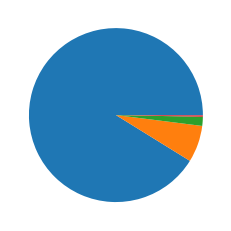

In [25]:
y = np.array([16370,1226,301,51,6])

plt.pie(y)
plt.show() 

In [26]:
first_q = df.loc[df['value_euro'] > 3.250000e+05]
first_q.count()

name                             13105
full_name                        13105
birth_date                       13105
age                              13105
height_cm                        13105
weight_kgs                       13105
positions                        13105
nationality                      13105
overall_rating                   13105
potential                        13105
value_euro                       13105
wage_euro                        13105
preferred_foot                   13105
international_reputation(1-5)    13105
weak_foot(1-5)                   13105
skill_moves(1-5)                 13105
work_rate                        13105
body_type                        13105
release_clause_euro              11713
club_team                        13105
club_rating                      13105
club_position                    13105
club_jersey_number               13105
club_join_date                   11609
contract_end_year                12994
national_team            

In [27]:
second_q = df.loc[df['value_euro'] > 7.000000e+05]
second_q.count()

name                             8780
full_name                        8780
birth_date                       8780
age                              8780
height_cm                        8780
weight_kgs                       8780
positions                        8780
nationality                      8780
overall_rating                   8780
potential                        8780
value_euro                       8780
wage_euro                        8780
preferred_foot                   8780
international_reputation(1-5)    8780
weak_foot(1-5)                   8780
skill_moves(1-5)                 8780
work_rate                        8780
body_type                        8780
release_clause_euro              7713
club_team                        8780
club_rating                      8780
club_position                    8780
club_jersey_number               8780
club_join_date                   7616
contract_end_year                8676
national_team                     813
national_rat

In [28]:
third_q = df.loc[df['value_euro'] >2.100000e+06]
third_q

,name,full_name,birth_date,age,height_cm,weight_kgs,positions,nationality,overall_rating,potential,...,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB
id,,,,,,,,,,,,,,,,,,,,,
158023,L. Messi,Lionel Andrés Messi Cuccittini,24/06/87,31,170.18,72.1,"CF,RW,ST",Argentina,94,94,...,64+2,61+2,61+2,61+2,64+2,59+2,48+2,48+2,48+2,59+2
190460,C. Eriksen,Christian Dannemann Eriksen,14/02/92,27,154.94,76.2,"CAM,RM,CM",Denmark,88,89,...,71+3,71+3,71+3,71+3,71+3,66+3,57+3,57+3,57+3,66+3
195864,P. Pogba,Paul Pogba,15/03/93,25,190.50,83.9,"CM,CAM",France,88,91,...,76+3,77+3,77+3,77+3,76+3,74+3,72+3,72+3,72+3,74+3
198219,L. Insigne,Lorenzo Insigne,04/06/91,27,162.56,59.0,"LW,ST",Italy,88,88,...,63+3,58+3,58+3,58+3,63+3,58+3,44+3,44+3,44+3,58+3
201024,K. Koulibaly,Kalidou Koulibaly,20/06/91,27,187.96,88.9,CB,Senegal,88,91,...,73+3,77+3,77+3,77+3,73+3,76+3,85+3,85+3,85+3,76+3
203376,V. van Dijk,Virgil van Dijk,08/07/91,27,193.04,92.1,CB,Netherlands,88,90,...,78+3,82+3,82+3,82+3,78+3,80+3,86+3,86+3,86+3,80+3
231747,K. Mbappé,Kylian Mbappé,20/12/98,20,152.40,73.0,"RW,ST,RM",France,88,95,...,66+3,62+3,62+3,62+3,66+3,62+3,54+3,54+3,54+3,62+3
153079,S. Agüero,Sergio Leonel Agüero del Castillo,02/06/88,30,172.72,69.9,ST,Argentina,89,89,...,58+3,56+3,56+3,56+3,58+3,53+3,47+3,47+3,47+3,53+3
167495,M. Neuer,Manuel Neuer,27/03/86,32,193.04,92.1,GK,Germany,89,89,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Clustered M.L

In [29]:
new_df = df[['value_euro','age']]
new_df

,value_euro,age
id,,
158023,110500000.0,31
190460,69500000.0,27
195864,73000000.0,25
198219,62000000.0,27
201024,60000000.0,27
203376,59500000.0,27
231747,81000000.0,20
153079,64500000.0,30
167495,38000000.0,32


In [30]:
# Use get_dummies() to create variables for text features.
dummy_df = pd.get_dummies(new_df, columns=['value_euro','age'])
dummy_df.head(15)

,value_euro_10000.0,value_euro_20000.0,value_euro_30000.0,value_euro_40000.0,value_euro_50000.0,value_euro_60000.0,value_euro_70000.0,value_euro_80000.0,value_euro_90000.0,value_euro_100000.0,...,age_36,age_37,age_38,age_39,age_40,age_41,age_42,age_44,age_45,age_46
id,,,,,,,,,,,,,,,,,,,,,
158023,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
190460,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
195864,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
198219,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
201024,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
203376,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
231747,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
153079,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
167495,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [31]:
scaled_X = StandardScaler().fit_transform(dummy_df)
print(scaled_X[0:5])

[[-0.02691834 -0.03339461 -0.03502652 ... -0.00746331 -0.00746331
  -0.00746331]
 [-0.02691834 -0.03339461 -0.03502652 ... -0.00746331 -0.00746331
  -0.00746331]
 [-0.02691834 -0.03339461 -0.03502652 ... -0.00746331 -0.00746331
  -0.00746331]
 [-0.02691834 -0.03339461 -0.03502652 ... -0.00746331 -0.00746331
  -0.00746331]
 [-0.02691834 -0.03339461 -0.03502652 ... -0.00746331 -0.00746331
  -0.00746331]]


In [32]:
pca=PCA(n_components=3)
x_pca = pca.fit_transform(scaled_X)
x_pca

array([[ 2.83583537,  0.84125838, -4.1886322 ],
       [ 0.07653226, -2.87620452,  0.45969683],
       [ 1.21891872, -0.15271532, -9.11482196],
       ...,
       [-0.75903404, -0.60859396, -0.66089102],
       [-0.76155467, -0.05668329, -1.21326687],
       [-1.29614808, -1.04880773, -0.17888263]])

In [33]:
index_values = (dummy_df.index.tolist())
index_values

[158023,
 190460,
 195864,
 198219,
 201024,
 203376,
 231747,
 153079,
 167495,
 179813,
 189511,
 192119,
 192448,
 194765,
 209331,
 211110,
 232363,
 135507,
 167664,
 168651,
 172871,
 175943,
 176676,
 184087,
 189332,
 189509,
 192387,
 193041,
 197781,
 198710,
 200145,
 201399,
 206585,
 208670,
 209499,
 211300,
 212188,
 212190,
 212198,
 212462,
 216460,
 216594,
 220793,
 220834,
 231443,
 41,
 41236,
 205498,
 205678,
 206113,
 207410,
 207566,
 207863,
 208418,
 208618,
 208808,
 209658,
 210008,
 210413,
 210514,
 212523,
 213345,
 213565,
 213331,
 216409,
 220440,
 221087,
 221992,
 222737,
 223959,
 224411,
 226226,
 226271,
 228702,
 230168,
 230225,
 230258,
 230658,
 231866,
 183498,
 183574,
 183711,
 184144,
 184200,
 184431,
 184484,
 184942,
 185122,
 185221,
 186345,
 186561,
 186627,
 187754,
 188803,
 189125,
 201455,
 202562,
 202685,
 203890,
 204024,
 204884,
 204923,
 205362,
 206467,
 207862,
 208093,
 208135,
 209889,
 210243,
 210617,
 212194,
 22611

In [34]:
ppp_df =pd.DataFrame(data = x_pca, columns=["PC 1", "PC 2", "PC 3"], index = index_values)
ppp_df.head()

,PC 1,PC 2,PC 3
158023,2.835835,0.841258,-4.188632
190460,0.076532,-2.876205,0.459697
195864,1.218919,-0.152715,-9.114822
198219,0.717614,-4.783630,-1.355334
201024,1.201806,-1.073183,4.144187


In [35]:
inertia = []
k = list(range(1,11))
for i in k:
    km =KMeans(n_clusters=i,random_state=0)
    km.fit(ppp_df)
    inertia.append(km.inertia_)

In [36]:
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", title="Elbow Curve", xticks=k)

:Curve   [k]   (inertia)

In [37]:
# df.dtypes['value_euro']# Initialize the K-Means model.
model = KMeans(n_clusters=4, random_state=0)

# Fit the model
model.fit(ppp_df)

# Predict clusters
predictions = model.predict(ppp_df)
print(predictions)
ppp_df["Class"] = model.labels_

[0 0 0 ... 0 0 1]


In [38]:
clustered_df = new_df.join(ppp_df, how='inner')
clustered_df.head()

,value_euro,age,PC 1,PC 2,PC 3,Class
158023,110500000.0,31,2.835835,0.841258,-4.188632,0
190460,69500000.0,27,0.076532,-2.876205,0.459697,0
195864,73000000.0,25,1.218919,-0.152715,-9.114822,0
198219,62000000.0,27,0.717614,-4.783630,-1.355334,0
201024,60000000.0,27,1.201806,-1.073183,4.144187,2


In [39]:
name_df = df['name']
name_df

id
158023                  L. Messi
190460                C. Eriksen
195864                  P. Pogba
198219                L. Insigne
201024              K. Koulibaly
203376               V. van Dijk
231747                 K. Mbappé
153079                 S. Agüero
167495                  M. Neuer
179813                 E. Cavani
189511           Sergio Busquets
192119               T. Courtois
192448             M. ter Stegen
194765              A. Griezmann
209331                  M. Salah
211110                 P. Dybala
232363               M. Škriniar
135507               Fernandinho
167664                G. Higuaín
168651                I. Rakitić
172871             J. Vertonghen
175943                D. Mertens
176676                   Marcelo
184087           T. Alderweireld
189332                Jordi Alba
189509                    Thiago
192387               C. Immobile
193041                  K. Navas
197781                      Isco
198710              J. Rodríguez
200145 

In [40]:
tester = new_df.join(name_df, how='inner')
tester

,value_euro,age,name
id,,,
158023,110500000.0,31,L. Messi
190460,69500000.0,27,C. Eriksen
195864,73000000.0,25,P. Pogba
198219,62000000.0,27,L. Insigne
201024,60000000.0,27,K. Koulibaly
203376,59500000.0,27,V. van Dijk
231747,81000000.0,20,K. Mbappé
153079,64500000.0,30,S. Agüero
167495,38000000.0,32,M. Neuer


In [41]:
# tester
# tester.hvplot.scatter(x="value_euro", y="age", by="name",
#                           xlabel="value_euro",
#                           ylabel="age",
#                           )
# too large to do

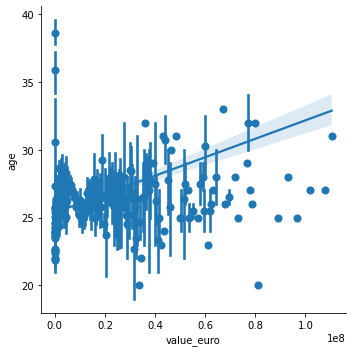

In [42]:
sns.lmplot(x="value_euro", y="age", data=tester, x_estimator=np.mean);


In [43]:
scrap_df = tester.sample(100)
scrap_df

,value_euro,age,name
id,,,
235205,240000.0,23,B. Gyamfi
164465,300000.0,32,T. McMahon
208194,325000.0,27,Kim Kyung Jung
188876,3800000.0,32,M. Valdifiori
224164,290000.0,24,Roger Riera
193035,170000.0,28,Salcedo
209535,150000.0,34,G. Warren
188058,3100000.0,29,A. Kravets
212535,350000.0,23,A. Calver


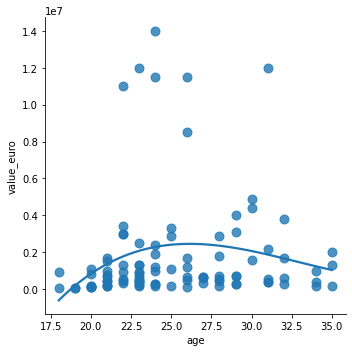

In [44]:

sns.lmplot(x="age", y="value_euro", data=scrap_df, order=3, ci=None, scatter_kws={"s": 80});

In [45]:
clustered_df = clustered_df.join(name_df, how='inner')
clustered_df.head()
#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
clustered_df["value_euro"]= model.labels_

# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(17954, 7)


,value_euro,age,PC 1,PC 2,PC 3,Class,name
158023,0,31,2.835835,0.841258,-4.188632,0,L. Messi
190460,0,27,0.076532,-2.876205,0.459697,0,C. Eriksen
195864,0,25,1.218919,-0.152715,-9.114822,0,P. Pogba
198219,0,27,0.717614,-4.783630,-1.355334,0,L. Insigne
201024,2,27,1.201806,-1.073183,4.144187,2,K. Koulibaly
203376,1,27,-1.612227,0.098569,-0.638782,1,V. van Dijk
231747,2,20,0.346799,0.294008,1.662835,2,K. Mbappé
153079,2,30,0.211127,2.588186,2.291021,2,S. Agüero
167495,0,32,-0.255051,0.254804,0.033027,0,M. Neuer
179813,2,32,1.289077,-1.562246,3.771771,2,E. Cavani


In [46]:
fig = px.scatter_3d(
    clustered_df, 
    x="PC 1", 
    y="PC 2", 
    z="PC 3", 
    color="Class", 
    symbol="Class", 
    hover_name="name", 
    hover_data=["value_euro", "age"])
fig.update_layout(legend=dict(x=0, y=1))
fig.show()

In [47]:
clustered_df.hvplot.table(columns=['value_euro', 'age', 'name','Class'], sortable=True, selectable=True)


:Table   [value_euro,age,name,Class]

In [48]:
# Print the total number of tradable cryptocurrencies.
clustered_df['name'].count()

17954

In [49]:
cluster_df = clustered_df[['value_euro', 'age']]
X_minmax = MinMaxScaler().fit_transform(cluster_df)
X_minmax

array([[0.        , 0.48275862],
       [0.        , 0.34482759],
       [0.        , 0.27586207],
       ...,
       [0.        , 0.17241379],
       [0.        , 0.13793103],
       [0.33333333, 0.06896552]])

In [59]:
# Create a new DataFrame that has the scaled data with the clustered_df DataFrame index.
index_values = (clustered_df.index.tolist())
plot_df = pd.DataFrame(
    data = X_minmax, columns=["value_euro_scaled", "age_scaled"], index = index_values)

# Add the "CoinName" column from the clustered_df DataFrame to the new DataFrame.
plot_df = plot_df.join(name_df, how='inner')

# Add the "Class" column from the clustered_df DataFrame to the new DataFrame. 
class_df = clustered_df['Class']
plot_df = plot_df.join(class_df, how='inner')

plot_df.head(10)

,value_euro_scaled,age_scaled,name,Class
158023,0.000000,0.482759,L. Messi,0
190460,0.000000,0.344828,C. Eriksen,0
195864,0.000000,0.275862,P. Pogba,0
198219,0.000000,0.344828,L. Insigne,0
201024,0.666667,0.344828,K. Koulibaly,2
203376,0.333333,0.344828,V. van Dijk,1
231747,0.666667,0.103448,K. Mbappé,2
153079,0.666667,0.448276,S. Agüero,2
167495,0.000000,0.517241,M. Neuer,0
179813,0.666667,0.517241,E. Cavani,2


In [51]:
# # Create a hvplot.scatter plot using x="TotalCoinsMined" and y="TotalCoinSupply".
# plot_df.hvplot.scatter(x="value_euro_scaled", y="age_scaled", by="Class",
#                           xlabel="value_euro",
#                           ylabel="age",
#                           )

# Linear Regression 

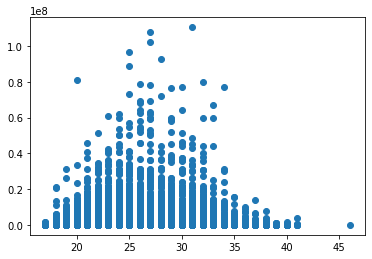

nan


NameError: name 'X_train' is not defined

In [60]:
y =new_df['value_euro']
x = new_df['age']

slope, intercept, r, p, std_err = stats.linregress(x, y)

def myfunc(x):
  return slope * x + intercept

mymodel = list(map(myfunc, x))

plt.scatter(x, y)
plt.plot(x, mymodel)
plt.show()
print(slope)


In [72]:
X = tester['value_euro'] #get a copy of dataset exclude last column
y = tester['age'] #get array of dataset in column 1st
print(X)
print(y)

id
158023    110500000.0
190460     69500000.0
195864     73000000.0
198219     62000000.0
201024     60000000.0
203376     59500000.0
231747     81000000.0
153079     64500000.0
167495     38000000.0
179813     60000000.0
189511     51500000.0
192119     53500000.0
192448     58000000.0
194765     78000000.0
209331     78500000.0
211110     89000000.0
232363     53500000.0
135507     20500000.0
167664     48500000.0
168651     46500000.0
172871     34000000.0
175943     45000000.0
176676     36500000.0
184087     44000000.0
189332     38000000.0
189509     51500000.0
192387     52000000.0
193041     30500000.0
197781     62500000.0
198710     59000000.0
200145     50500000.0
201399     64500000.0
206585     31000000.0
208670     38000000.0
209499     34000000.0
211300     42500000.0
212188     40000000.0
212190     36500000.0
212198     40500000.0
212462     31000000.0
216460     34000000.0
216594     40500000.0
220793     34000000.0
220834     41500000.0
231443     46000000.0
41     

In [77]:
X.dropnan
X

AttributeError: 'Series' object has no attribute 'dropnan'

In [73]:
X.shape

(17954,)

In [74]:
y.shape

(17954,)

In [70]:

from sklearn.model_selection import train_test_split 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1/3, random_state=0)

from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)
viz_train = plt
viz_train.scatter(X_train, y_train, color='red')
viz_train.plot(X_train, regressor.predict(X_train), color='blue')
viz_train.title('val n age')
viz_train.xlabel('Year of Experience')
viz_train.ylabel('Salary')
viz_train.show()

# Visualizing the Test set results
viz_test = plt
viz_test.scatter(X_test, y_test, color='red')
viz_test.plot(X_train, regressor.predict(X_train), color='blue')
viz_test.title('Salary VS Experience (Test set)')
viz_test.xlabel('Year of Experience')
viz_test.ylabel('Salary')
viz_test.show()

ValueError: Expected 2D array, got 1D array instead:
array=[3200000. 9000000. 8000000. ...  375000.  650000.  450000.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.